# Targeted Adversarial Attacks

In this notebook, we'll focus on targeted adversarial attacks, where the goal is to force a neural network to classify an image as a specific target class. This is more challenging than untargeted attacks but produces more interesting results.

## Targeted vs. Untargeted Attacks

- **Untargeted Attack**: The goal is to cause any misclassification. We maximize the loss for the correct class.
- **Targeted Attack**: The goal is to cause misclassification to a specific target class. We minimize the loss for the target class (or maximize the probability of the target class).

In [22]:
# Import necessary libraries
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Import our utility functions
import sys
sys.path.append('../')
from src.models import load_pretrained_model, predict, get_imagenet_label, get_imagenet_index
from src.utils import load_image, preprocess_image, deprocess_tensor, show_comparison, calculate_perturbation
from src.adversarial_attacks import fgsm_attack, pgd_attack, deepfool_attack

## Step 1: Load a Pretrained Model and Image

/home/coohrentiin/miniconda3/envs/torch/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/coohrentiin/miniconda3/envs/torch/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loaded ResNet model


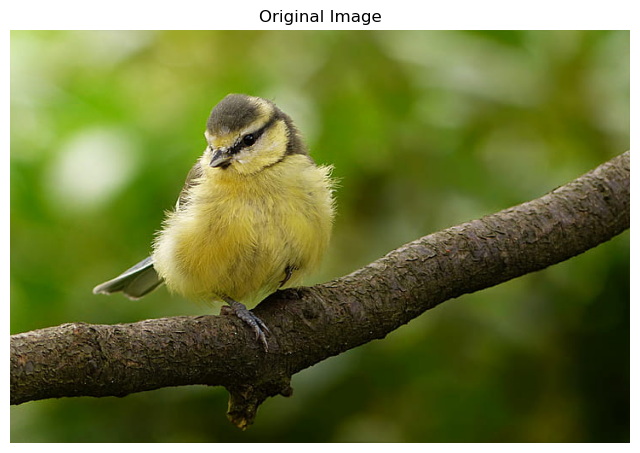

Prediction: goldfinch with 83.48% confidence


In [18]:
# Load a pretrained ResNet-50 model
model = load_pretrained_model('resnet50')
print(f"Loaded {model.__class__.__name__} model")

# Path to sample images
sample_dir = '../data/sample_images/'
os.makedirs(sample_dir, exist_ok=True)

# Try to load a cat image
image_path = os.path.join(sample_dir, 'bird.jpg')
if not os.path.exists(image_path):
    print(f"Please add a cat image to {image_path}")
else:
    # Load and display the image
    original_image = load_image(image_path)
    plt.figure(figsize=(8, 8))
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis('off')
    plt.show()
    
    # Preprocess the image for the model
    input_tensor = preprocess_image(original_image)
    
    # Get the model's prediction
    class_idx, class_name, confidence = predict(model, input_tensor)
    print(f"Prediction: {class_name} with {confidence:.2%} confidence")

## Step 2: Define Target Classes

Let's define a few interesting target classes from ImageNet to use in our attacks.

In [42]:
# Define some interesting target classes from ImageNet
target_classes = {
    "Golden Retriever": get_imagenet_index("Golden Retriever"),  # Golden retriever
    "pirate ship": get_imagenet_index("pirate ship") ,  # Container ship
    "sports car": get_imagenet_index("sports car") ,  # Sports car
    "pizza": get_imagenet_index("pizza") ,  # Pizza
    "hummingbird": get_imagenet_index("hummingbird"),
    "guenon": get_imagenet_index("guenon")  # White-headed capuchin 
}

# Print the target classes
print("Target classes:")
for name, idx in target_classes.items():
    print(f"{name}: Class {idx} ({get_imagenet_label(idx)})")

Target classes:
Golden Retriever: Class 207 (Golden Retriever)
pirate ship: Class 724 (pirate ship)
sports car: Class 817 (sports car)
pizza: Class 963 (pizza)
hummingbird: Class 94 (hummingbird)
guenon: Class 370 (guenon)


## Step 3: Targeted FGSM Attack

Let's create targeted adversarial examples using the Fast Gradient Sign Method.

In [40]:
# Function to create and display targeted adversarial examples
def create_targeted_example(model, input_tensor, original_image, target_class, 
                           target_name, epsilon=0.03, attack_fn=fgsm_attack):
    # Original prediction
    orig_idx, orig_name, orig_conf = predict(model, input_tensor)
    original_pred = (orig_idx, orig_name, orig_conf)
    
    # Create a targeted adversarial example
    adv_tensor = attack_fn(model, input_tensor, target=target_class, epsilon=epsilon)
    
    # Convert the adversarial tensor back to an image
    adv_image = deprocess_tensor(adv_tensor)
    
    # Get the model's prediction on the adversarial image
    adv_idx, adv_name, adv_conf = predict(model, adv_tensor)
    adversarial_pred = (adv_idx, adv_name, adv_conf)
    
    # Calculate the perturbation
    perturbation = calculate_perturbation(input_tensor, adv_tensor)
    
    # Show the comparison
    print(f"Original: {orig_name} with {orig_conf:.2%} confidence")
    print(f"Target: {target_name} (Class {target_class})")
    print(f"Adversarial: {adv_name} with {adv_conf:.2%} confidence")
    print(f"Attack {'succeeded' if adv_idx == target_class else 'failed'}\n")
    
    # Show the images
    show_comparison(original_image, adv_image, perturbation, original_pred, adversarial_pred)
    
    return adv_tensor, adv_image

FGSM Targeted Attacks with Different Epsilon Values:

Epsilon = 0.01
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: guenon with 29.92% confidence
Attack succeeded



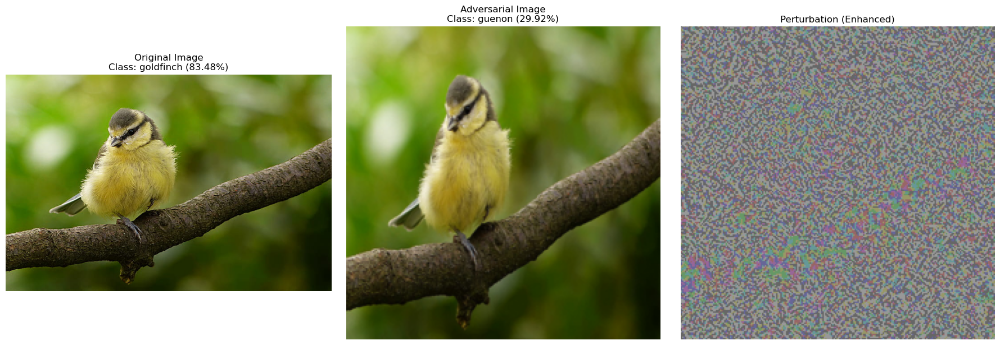

Epsilon = 0.05
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: guenon with 72.39% confidence
Attack succeeded



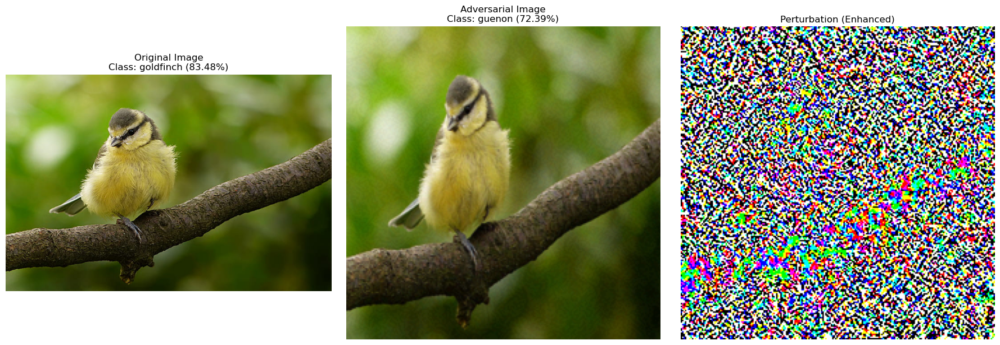

Epsilon = 0.1
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: guenon with 88.05% confidence
Attack succeeded



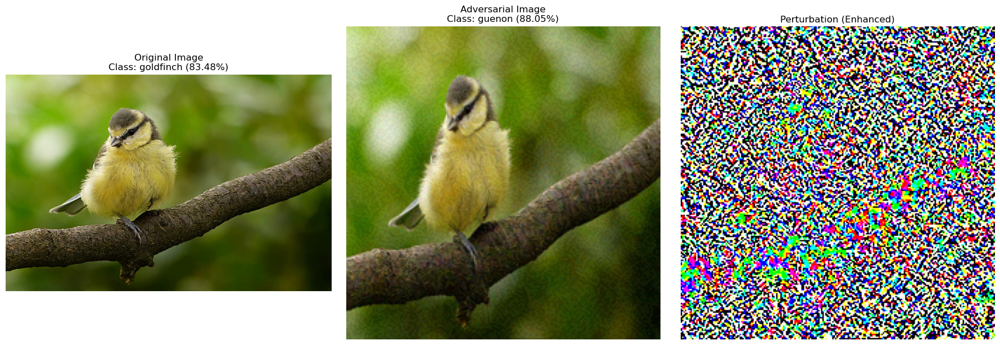

Epsilon = 0.2
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: guenon with 91.51% confidence
Attack succeeded



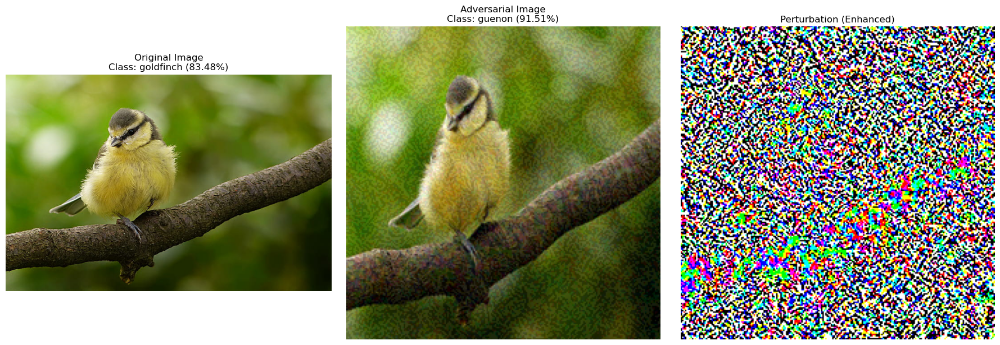

Epsilon = 0.5
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: guenon with 60.79% confidence
Attack succeeded



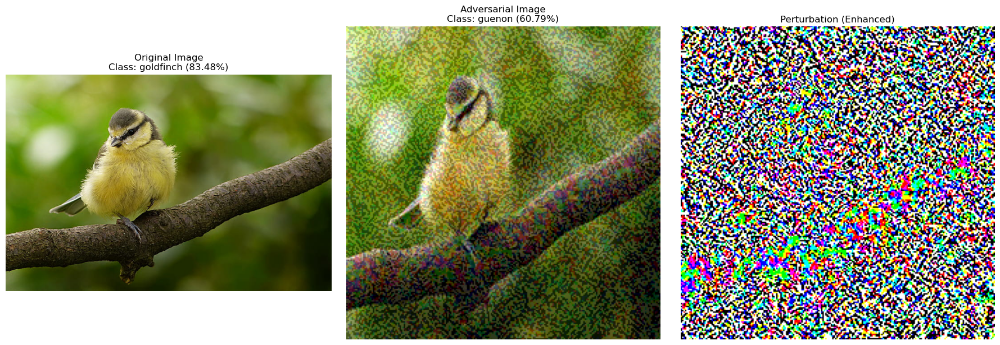

Epsilon = 1.0
Original: goldfinch with 83.48% confidence
Target: guenon (Class 370)
Adversarial: chain-link fence with 19.20% confidence
Attack failed



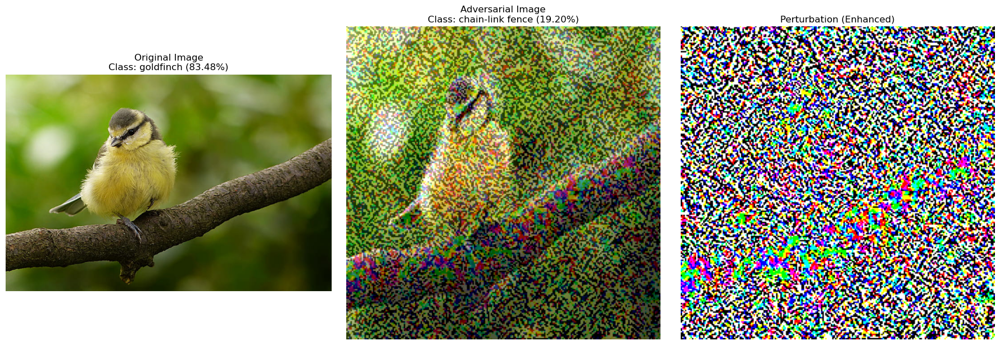

In [44]:
# Try FGSM targeted attacks with different epsilon values
epsilons = [0.01,0.05, 0.1, 0.2, 0.5,1.0]
target_class = target_classes["guenon"]
target_name = get_imagenet_label(target_class)

print("FGSM Targeted Attacks with Different Epsilon Values:\n")
for eps in epsilons:
    print(f"Epsilon = {eps}")
    _, _ = create_targeted_example(model, input_tensor, original_image, 
                                target_class, target_name, epsilon=eps)

## Step 4: Targeted PGD Attack

Now let's try the more powerful PGD attack for targeted misclassification.

In [45]:
# Modified PGD attack function that supports targeted attacks
def targeted_pgd_attack(model, image, target, epsilon=0.03, alpha=0.001, iterations=40):
    # Make sure input is a tensor with requires_grad=True
    if not isinstance(image, torch.Tensor):
        raise ValueError("Input must be a torch.Tensor")
    
    # Create a copy of the input
    original_image = image.clone().detach()
    adversarial_image = original_image.clone().detach()
    
    # Make sure target is a tensor
    if not isinstance(target, torch.Tensor):
        target = torch.tensor([target], device=image.device)
    
    # Loss function
    loss_fn = torch.nn.CrossEntropyLoss()
    
    # PGD attack loop
    for i in range(iterations):
        # Make sure requires_grad is set
        adversarial_image.requires_grad = True
        
        # Forward pass
        output = model(adversarial_image)
        
        # For targeted attack, we minimize the loss for the target class
        # (equivalent to maximizing the probability of the target class)
        loss = -loss_fn(output, target)
        
        # Backward pass
        model.zero_grad()
        loss.backward()
        
        # Get gradient
        grad = adversarial_image.grad.data
        
        # Update adversarial image
        with torch.no_grad():
            adversarial_image = adversarial_image.detach() - alpha * torch.sign(grad)
            
            # Project back to epsilon ball around original image
            delta = torch.clamp(adversarial_image - original_image, -epsilon, epsilon)
            adversarial_image = original_image + delta
    
    return adversarial_image

PGD Targeted Attacks for Different Target Classes:

Target: Golden Retriever (Golden Retriever)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 99.82% confidence
Attack failed



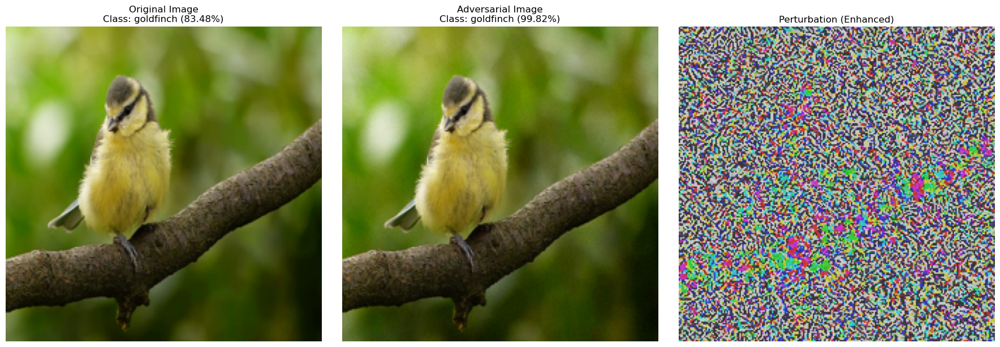

Target: pirate ship (pirate ship)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 99.83% confidence
Attack failed



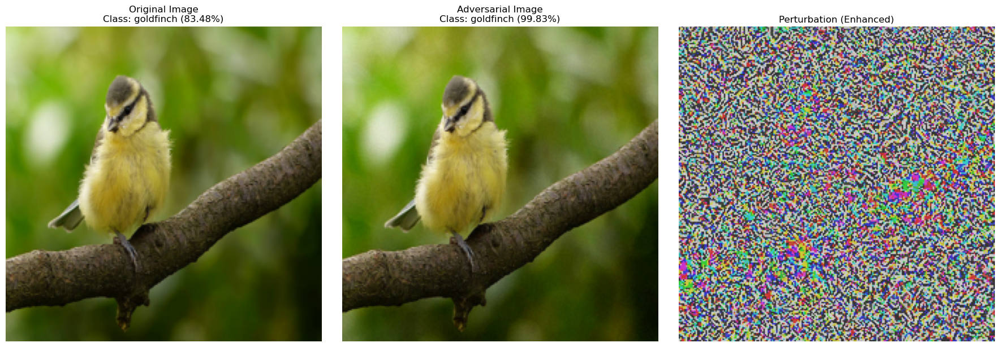

Target: sports car (sports car)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 98.10% confidence
Attack failed



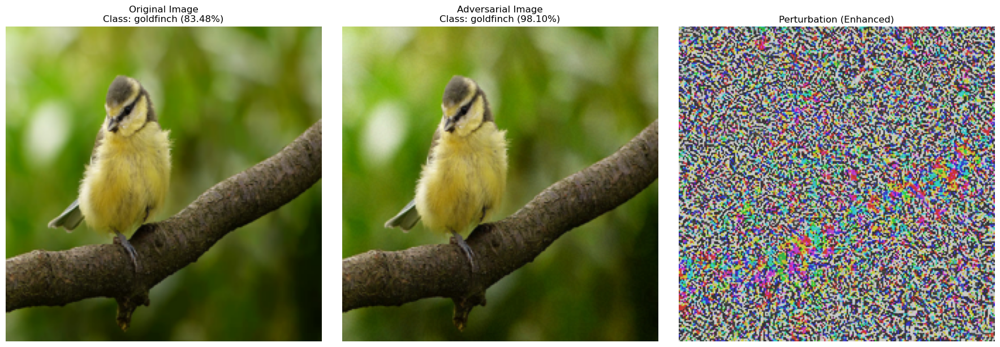

Target: pizza (pizza)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 99.53% confidence
Attack failed



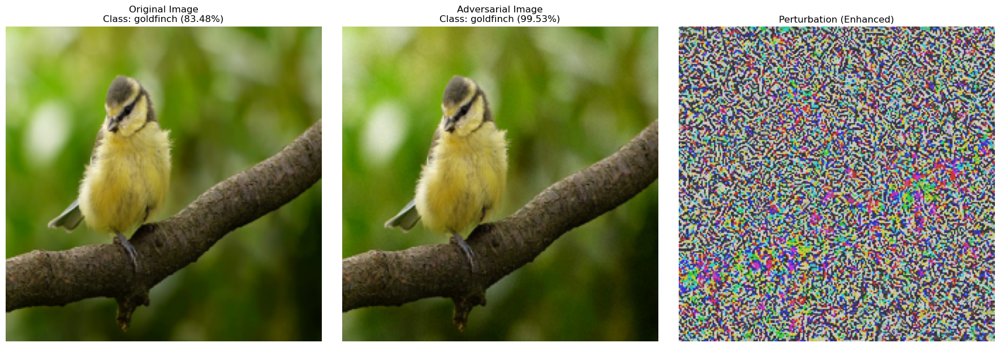

Target: hummingbird (hummingbird)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 99.94% confidence
Attack failed



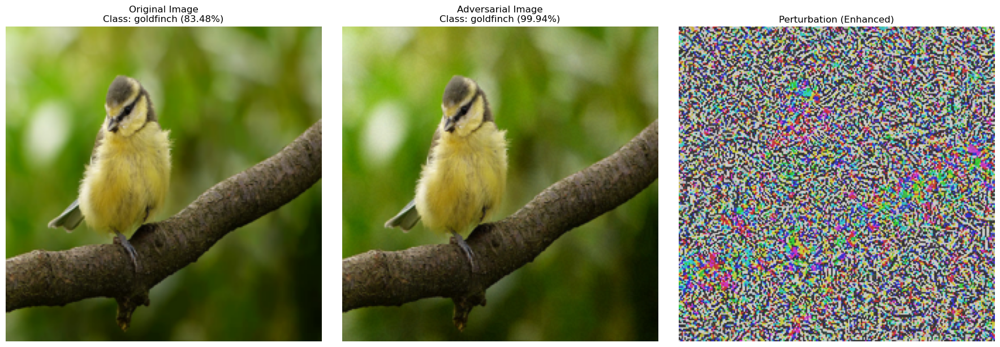

Target: guenon (guenon)
Original: goldfinch with 83.48% confidence
Adversarial: goldfinch with 99.98% confidence
Attack failed



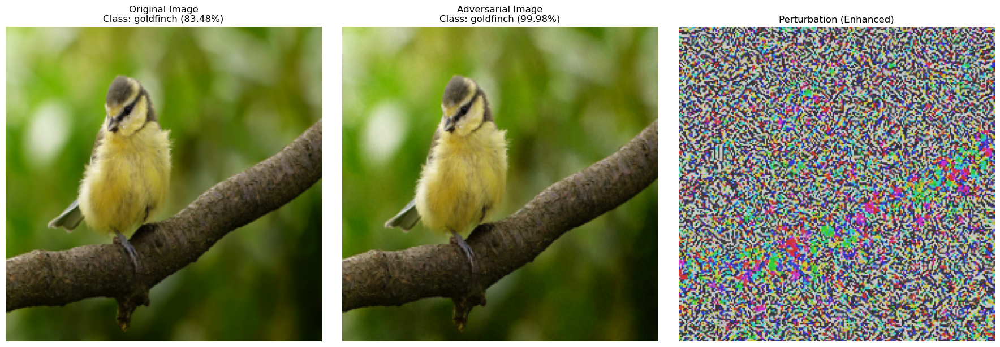

In [46]:
# Try targeted PGD attacks with different target classes
print("PGD Targeted Attacks for Different Target Classes:\n")
alpha = 0.05
iterations = 100

for target_name, target_idx in target_classes.items():
    class_name = get_imagenet_label(target_idx)
    print(f"Target: {target_name} ({class_name})")
    
    # Create targeted adversarial example
    adv_tensor = targeted_pgd_attack(model, input_tensor, target_idx, 
                                   alpha=alpha, iterations=iterations)
    
    # Convert to image and get prediction
    adv_idx, adv_name, adv_conf = predict(model, adv_tensor)
    
    # Calculate perturbation
    perturbation = calculate_perturbation(input_tensor, adv_tensor)
    
    # Show the comparison
    orig_idx, orig_name, orig_conf = predict(model, input_tensor)
    original_pred = (orig_idx, orig_name, orig_conf)
    adversarial_pred = (adv_idx, adv_name, adv_conf)
    
    print(f"Original: {orig_name} with {orig_conf:.2%} confidence")
    print(f"Adversarial: {adv_name} with {adv_conf:.2%} confidence")
    print(f"Attack {'succeeded' if adv_idx == target_idx else 'failed'}\n")
    
    show_comparison(deprocess_tensor(input_tensor.clone()), deprocess_tensor(adv_tensor.clone()), perturbation, original_pred, adversarial_pred)

## Step 5: Compare Different Models

Let's see if targeted adversarial examples transfer between different model architectures.

/home/coohrentiin/miniconda3/envs/torch/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/coohrentiin/miniconda3/envs/torch/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/coohrentiin/miniconda3/envs/torch/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`

Creating targeted adversarial example for ResNet-50 (Target: pizza)...

Predictions on original image:
ResNet-50: goldfinch with 79.64% confidence
VGG16: goldfinch with 42.15% confidence
MobileNetV2: goldfinch with 79.64% confidence
InceptionV3: goldfinch with 99.72% confidence

Predictions on adversarial image (created for ResNet-50):
ResNet-50: goldfinch with 68.11% confidence ✗
VGG16: bee eater with 44.09% confidence ✗
MobileNetV2: goldfinch with 68.11% confidence ✗
InceptionV3: goldfinch with 100.00% confidence ✗


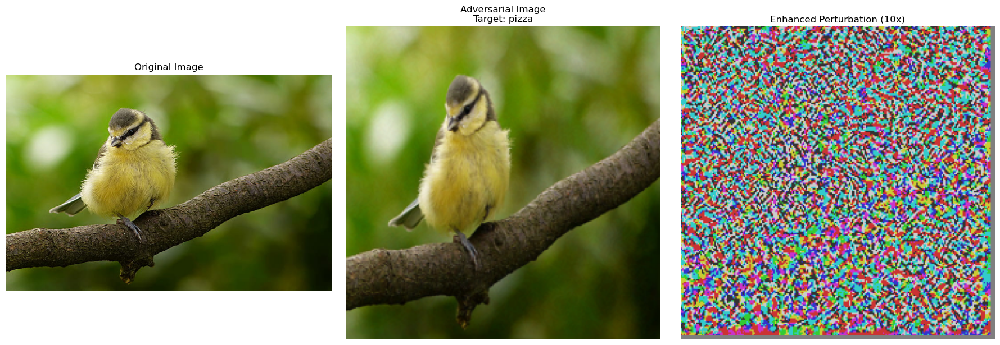

In [ ]:
# Load different models
models = {
    'ResNet-50': model,  # We already loaded this one
    'VGG16': load_pretrained_model('vgg16'),
    'MobileNetV2': load_pretrained_model('mobilenet_v2'),
    'InceptionV3': load_pretrained_model('inception_v3'),
}

# Choose a target class
target_name = 'pizza'
target_class = target_classes[target_name]
target_label = get_imagenet_label(target_class)

# Create a targeted adversarial example for ResNet-50
print(f"Creating targeted adversarial example for ResNet-50 (Target: {target_label})...")
iterations = 200
alpha = 1

adv_tensor = targeted_pgd_attack(models['ResNet-50'], input_tensor, target_class, 
                               alpha=alpha, iterations=iterations)

# Test on all models
print("\nPredictions on original image:")
for model_name, model in models.items():
    idx, name, conf = predict(model, input_tensor)
    print(f"{model_name}: {name} with {conf:.2%} confidence")

print("\nPredictions on adversarial image (created for ResNet-50):")
for model_name, model in models.items():
    idx, name, conf = predict(model, adv_tensor)
    success = "✓" if idx == target_class else "✗"
    print(f"{model_name}: {name} with {conf:.2%} confidence {success}")

# Display the adversarial image
adv_image = deprocess_tensor(adv_tensor)
perturbation = calculate_perturbation(input_tensor, adv_tensor)

# Enhanced perturbation display
enhanced_perturbation = perturbation * 10 + 0.5
enhanced_perturbation = np.clip(enhanced_perturbation, 0, 1)

plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(adv_image)
plt.title(f"Adversarial Image\nTarget: {target_label}")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(enhanced_perturbation)
plt.title("Enhanced Perturbation (10x)")
plt.axis('off')

plt.tight_layout()
plt.show()

## Conclusion

In this notebook, we explored targeted adversarial attacks, where we aim to force a neural network to classify an image as a specific target class. We demonstrated:

1. How to create targeted adversarial examples using FGSM and PGD methods
2. The effect of different epsilon values (perturbation magnitudes) on attack success
3. How to target different classes (dog, ship, car, etc.)
4. Whether targeted adversarial examples transfer between different model architectures

Key observations:

- Targeted attacks generally require larger perturbations or more iterations than untargeted attacks
- PGD is more effective than FGSM for targeted attacks due to its iterative nature
- Some target classes are easier to achieve than others
- Targeted adversarial examples sometimes transfer between models, but the transfer success rate is usually lower than for untargeted attacks

Understanding targeted adversarial attacks is important because they demonstrate a more sophisticated security threat - the ability to manipulate neural networks in a controlled way rather than simply causing random misclassifications.